# Figure 7 Codes

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
current_path = os.getcwd()
parent_directory = os.path.dirname(current_path)
sys.path.append(parent_directory)  # Adds the parent directory to the Python path
from Class.jenie import Jenie
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Figure C & D

Brain projections of cell types identified in the 2D UMAP in localized within the SVZ human tissue section imaged via MERFISH

In [3]:
# read human data
human = sc.read("../DataF/fig7/SVZMER.h5ad")

In [4]:
humanj = Jenie(human, "Human", "human", "human")

In [5]:
humanj.recluster(0.26)

/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


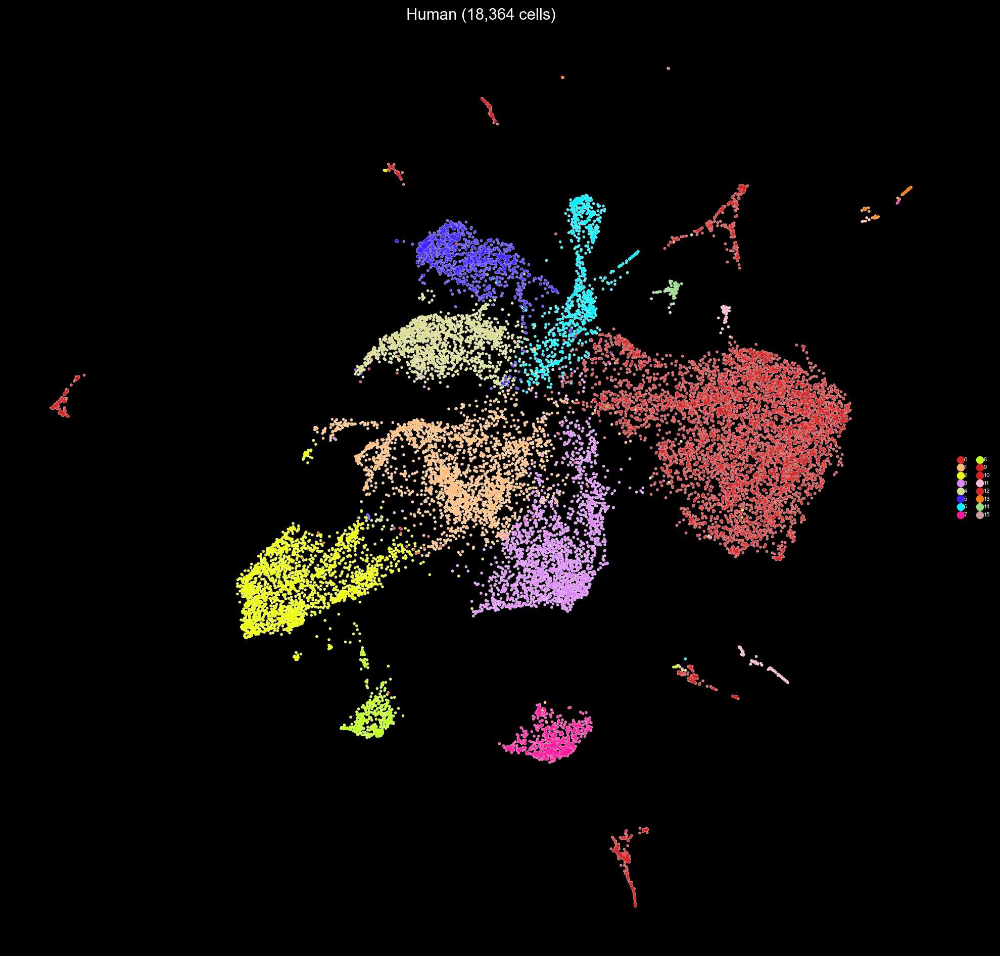

In [6]:
humanj.umap(legend="right margin", style="dark_background")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


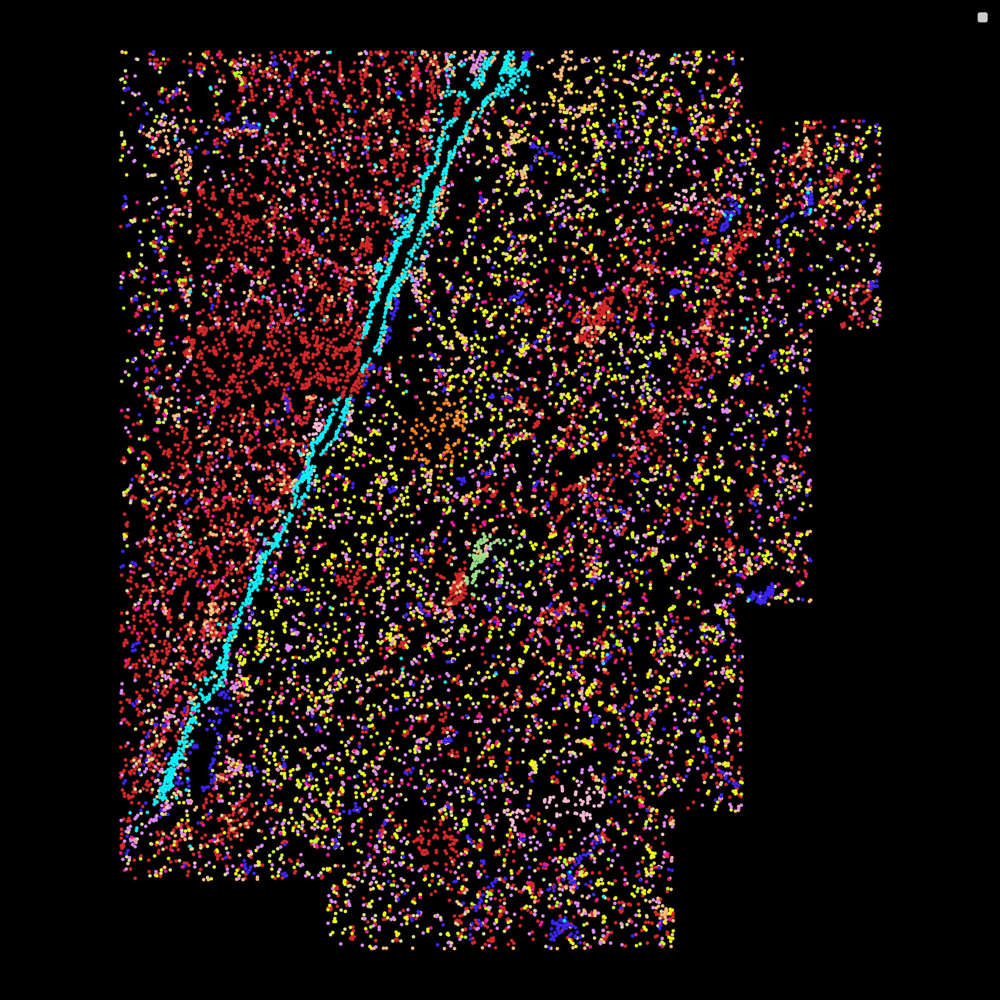

In [7]:
humanj.plot_cluster_scdata("leiden")

# Figure E

Heatmap Pearson correlation between the cell clusters identified via MERFISH in the human and mouse SVZ

In [8]:
from scipy.stats import zscore
from scipy.stats import pearsonr
import matplotlib.pyplot as plt
import seaborn as sns

# read mice reference
cbm2 = sc.read("../DataF/fig1/CBM2_new_immmature_dg.h5ad")
# label general celltypes
cbm2.obs["gen_celltype"] = cbm2.obs["MERFISH celltype"].map(Jenie.merfish_celltype_general)


plt.style.use("default")

# human data
d = humanj.get_cluster([str(x) for x in range(7)], "leiden")
d.var.index = d.var.index.str.capitalize()

refdata = cbm2

common_genes = refdata.var_names.intersection(d.var_names)
cbmtemp = d[:,common_genes]
refdata = refdata[:,common_genes]

# create a dataframe of correlations
refdf = refdata.to_df()
refdf["cluster"] = refdata.obs["gen_celltype"]
refmeans = refdf.groupby("cluster").mean()
cbmdf = cbmtemp.to_df()
cbmdf["cluster"] = cbmtemp.obs["leiden"]
cbmmeans = cbmdf.groupby("cluster").mean()

refmeans = zscore(refmeans, axis=0)
cbmmeans = zscore(cbmmeans, axis=0)

# Get all the correlations
ps = []
for name1, row1 in cbmmeans.iterrows():
    ps_ = []
    for name2, row2 in refmeans.iterrows():
        ps_.append(pearsonr(row1, row2)[0])
    ps.append(ps_)

# resulting dataframe
cordf = pd.DataFrame(ps, index=cbmmeans.index, columns=refmeans.index)

In [9]:
# row order
order = ["0", "2", "6", "3", "1", "4","5",]
# column order
order2 = ["Endothelial cells", "Microglia",  "Astrocytes", "Ependymal cells", "Neurons","Oligodendrocytes",]
human_colors = [
    "#d62728",
    "#eeff00",
    "#00f2ff",
    "#dd86f7",
    "#ffbb78",
    "#dbdb8d",
    "#3d24ff",
    ]

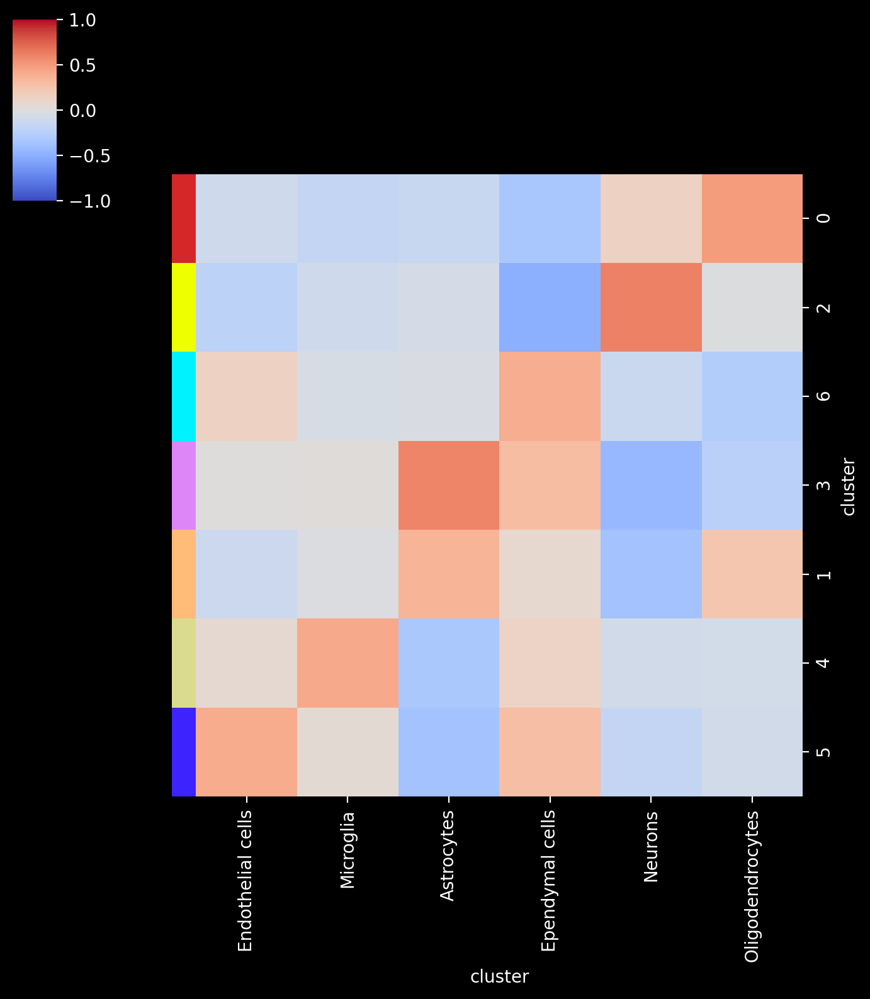

In [10]:
plt.style.use("dark_background")
fig = sns.clustermap(cordf.loc[order, order2], cmap='coolwarm', vmax=1, vmin=-1, figsize=(7,8), yticklabels=True, xticklabels=True, row_cluster=False, row_colors=human_colors, col_cluster=False)


# Figure F

Brain projection (left) and 2D UMAPs (right) of ependymal cell sub-clusters identified in the the human SVZ and the 18th highest expressed genes within each of the ependymal subclusters.

/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/tools/_leiden.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_added] = pd.Categorical(
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/kjeni

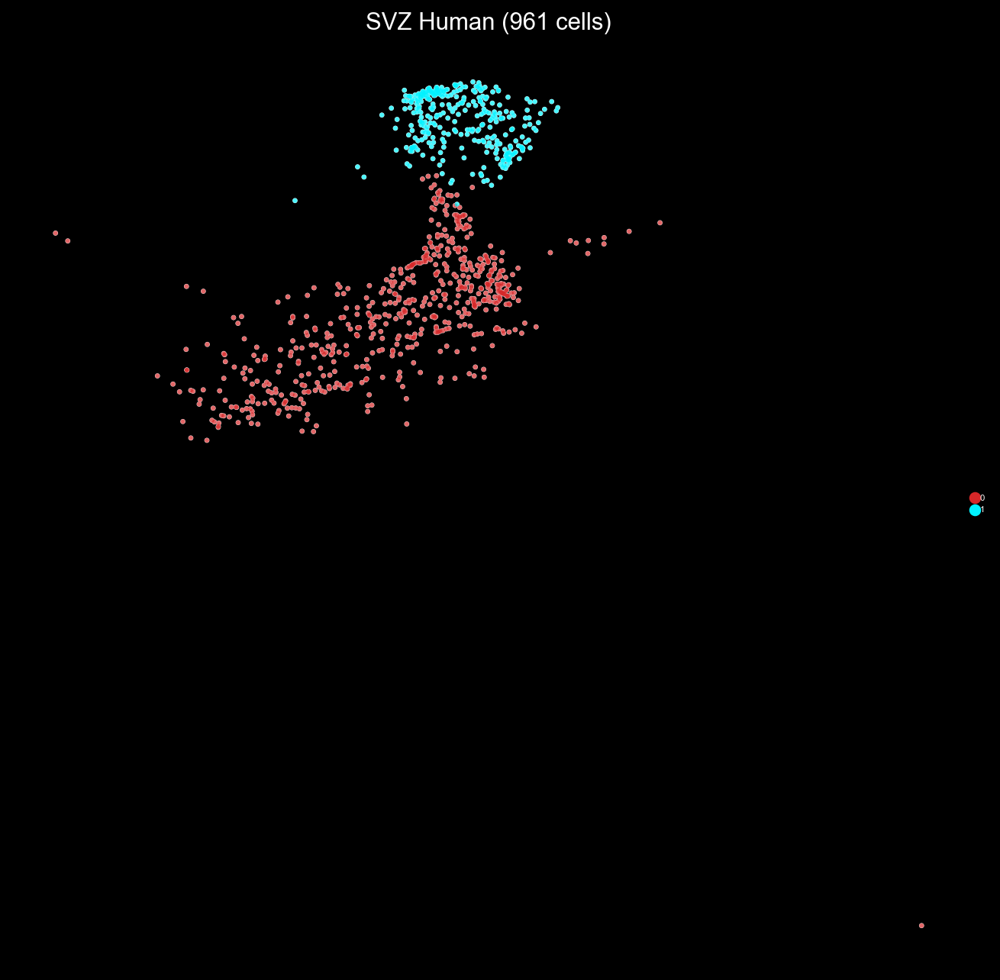

In [12]:
# get only ependymal cluster
cl6 = humanj.get_cluster(["6"], group="leiden")
cl6j = Jenie(cl6, "SVZ Human", "svz_human", "human_svz")

# recluster ependymal
cl6j.recluster(0.05)
cl6j.change_pallete("human_svz")

# umap 
cl6j.umap(legend="right margin", style="dark_background", size=30, fig=(10,10), groups=["0","1"], ref=cl6j.data, bg_color="black")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


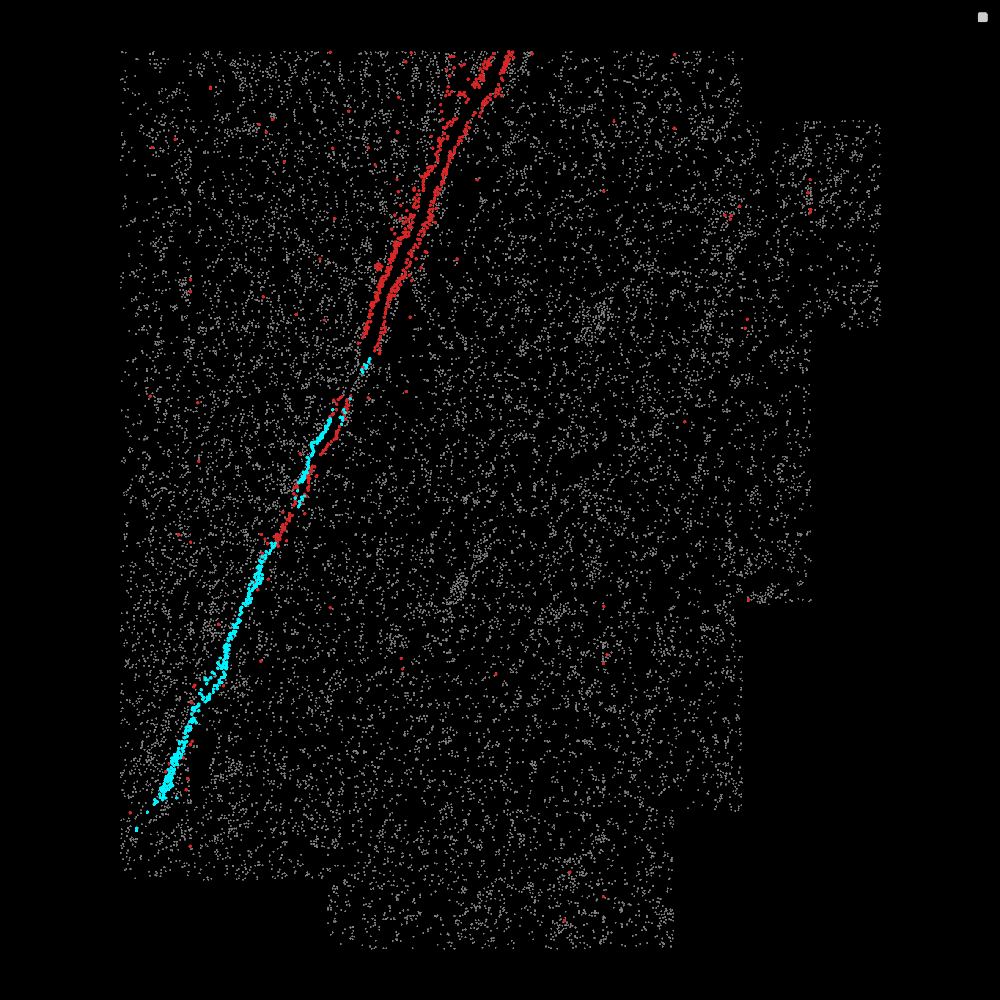

In [13]:
cl6j.plot_cluster_scdata("leiden", ref=human, clusters=["0", "1"])

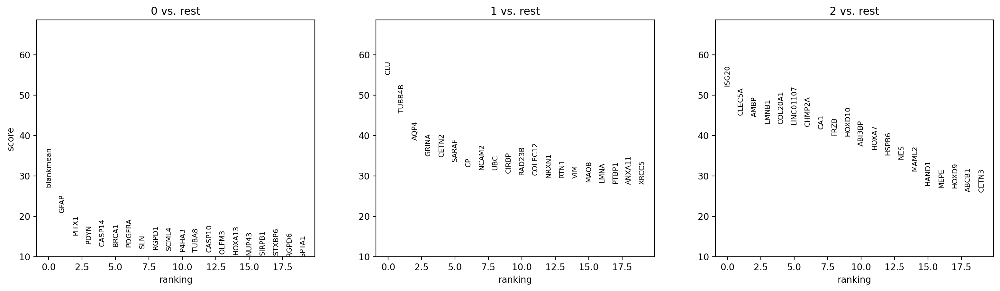

In [14]:
cl6j.rank_genes_groups()

# Figure G & H

UMAP and spatial projection of Ptbp1 expression in human svz

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


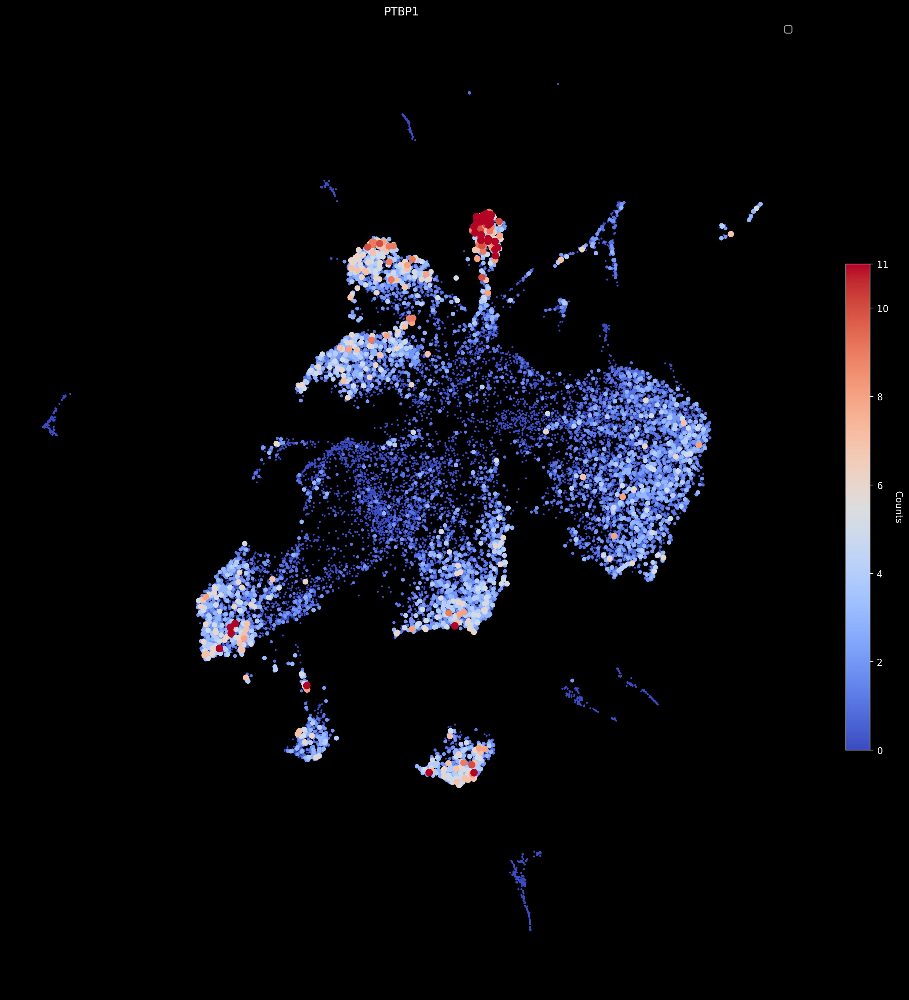

In [17]:
humanj.plot_gene_scdata("PTBP1", percentile=99.8, umap=True, sz_max=200)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


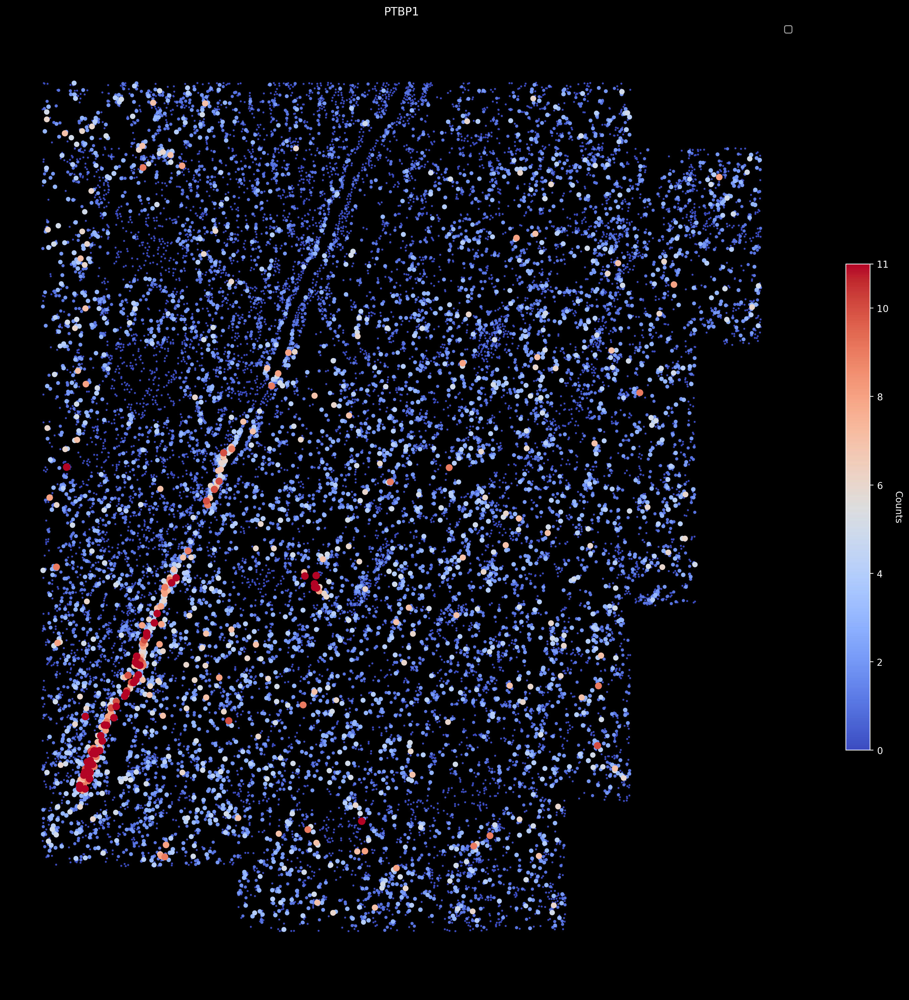

In [18]:
humanj.plot_gene_scdata("PTBP1", percentile=99.8, umap=False, sz_max=200)

In [19]:
# humanj.plot_gene_scdata("DCX", percentile=99.8, umap=False, sz_max=200)

In [20]:
# humanj.plot_gene_scdata("IGFBPL1", percentile=99.8, umap=False, sz_max=200)

In [21]:
# humanj.plot_gene_scdata("SOX11", percentile=99.8, umap=False, sz_max=200)

# Figure I

Boxplot of Ptbp1 expression in different celltypes

### Recluster the ependymal cells and put them back in the original data

In [16]:
cl6 = cl6j.data.copy()

cl6.obs["leiden"] = cl6.obs.leiden.apply(lambda x: "0e" if x == "2" else f"{x}e")

a = [str(x) for x in range(16)]
a.remove("6")

_human = humanj.get_cluster(a, "leiden")
comhum = anndata.concat([_human, cl6])

humanj = Jenie(comhum, "human", "human")

### Label celltypes

In [17]:
mapping = {
    "0e":"Ependymal 1",
    "1e":"Ependymal 2",
    "0":"Oligos (MBP)",
    "1":"Astrocytes",
    "2":"Glut Neurons",
    "3":"Astrocytes Pink",
    "4":"Microglia",
    "5":"Endothelial",
    "6":"Ependymal",
    "7":"Oligos (Olig1)",
    "8":"GABA neurons",
    "9":"Astrocytes",
    "10":"Astrocytes",
    "11":"11",
    "12":"Astrocytes",
    "13":"13",
    "14":"14",
    "15":"15"
}

In [18]:
humanj.data.obs["human_clusters"] = humanj.data.obs.leiden.map(mapping)

### Plot quantification of selected celltypes

In [19]:
mapping2 = ['Astrocytes',
 'GABA neurons',
 'Ependymal 2',
 'Oligos (Olig1)',
 'Oligos (MBP)',
 'Endothelial',
 'Astrocytes Pink',
 'Microglia',
 'Glut Neurons',
 'Ependymal 1',
 'Ependymal']

In [20]:
adata2 = humanj.data[humanj.data.obs["human_clusters"].isin(mapping2)]

None
Y-axis minimum value: -0.8500000000000001
Y-axis maximum value: 17.85


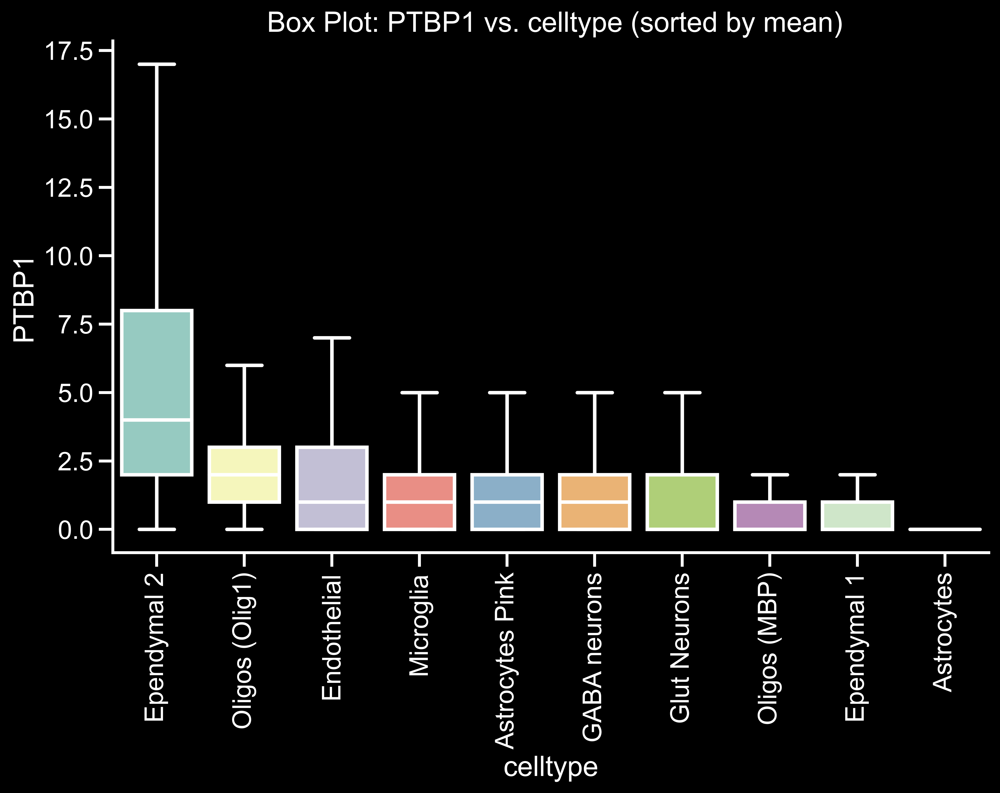

In [21]:
Jenie.ptb_boxplot(adata2, mapping2, len(mapping2), "human_clusters", gene="PTBP1", outlier=False)

# Figure J

Dot plot representation of proposed PTBP1 dependent factors (Ptbp1, Rest, Brn2, Ptbp2) expression in  Ependymal cells 1 and 2

/Users/kjenie/DataspellProjects/ptb_timepoints/.conda/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


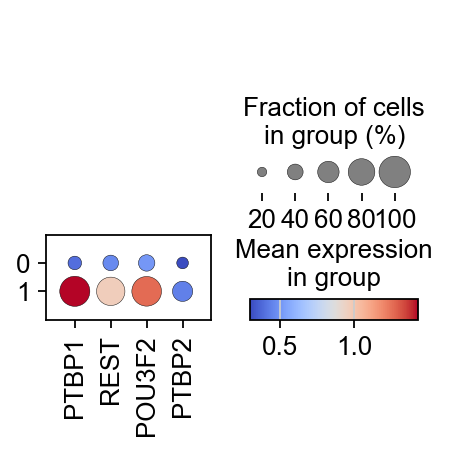

In [15]:
plt.style.use("default")
sc.set_figure_params(figsize=(5,4))
marker_genes = [
    'Ptbp1', 
    'Rest',
    'Pou3f2',
    'Ptbp2',
]

d = cl6j.get_cluster(["0","1"], group="leiden")
sc.pl.dotplot(d, [x.upper() for x in marker_genes], 'leiden', dendrogram=False, cmap="coolwarm", show=True)


# Figure M

Human cells ingested into the murine transcriptional space. SVZ Stage 1 cells

In [42]:
human.var.index = human.var.index.str.capitalize()

In [43]:
ref = sc.read("../DataF/fig5/final_reference_4week_svz.h5ad")

var_names = ref.var_names.intersection(human.var_names)
ref2 = ref[:, var_names]
d_ing = human[:, var_names]

sc.pp.pca(d_ing)
sc.pp.neighbors(d_ing, n_neighbors=15)
sc.tl.umap(d_ing)

sc.pp.pca(ref2)
sc.pp.neighbors(ref2, n_neighbors=15)
sc.tl.umap(ref2)

sc.tl.ingest(d_ing, ref2, obs="neurogenesis_pathway")

h3
Distances type: <class 'scipy.sparse._csr.csr_matrix'>


h1


In [44]:
d_ing.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,leiden,x,neurogenesis_pathway
17600001,621,6.432940,2712.609043,7.906035,3,x,2-astro
17600002,252,5.533389,717.125000,6.576644,0,x,56
17600003,391,5.971262,1191.233156,7.083583,5,x,2
17600004,420,6.042633,1027.345745,6.935707,0,x,49-oligo
17600005,374,5.926926,1845.302305,7.520940,3,x,2
...,...,...,...,...,...,...,...
31100242,78,4.369448,281.038121,5.642042,1,x,63
31100243,40,3.713572,47.007979,3.871367,1,x,63
31100244,111,4.718499,162.019504,5.093870,1,x,22
31100246,30,3.433987,76.005319,4.343874,1,x,63


In [45]:
humaningj = Jenie(d_ing, "human_ing", "human_ing", "neurogenesis_pathway")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


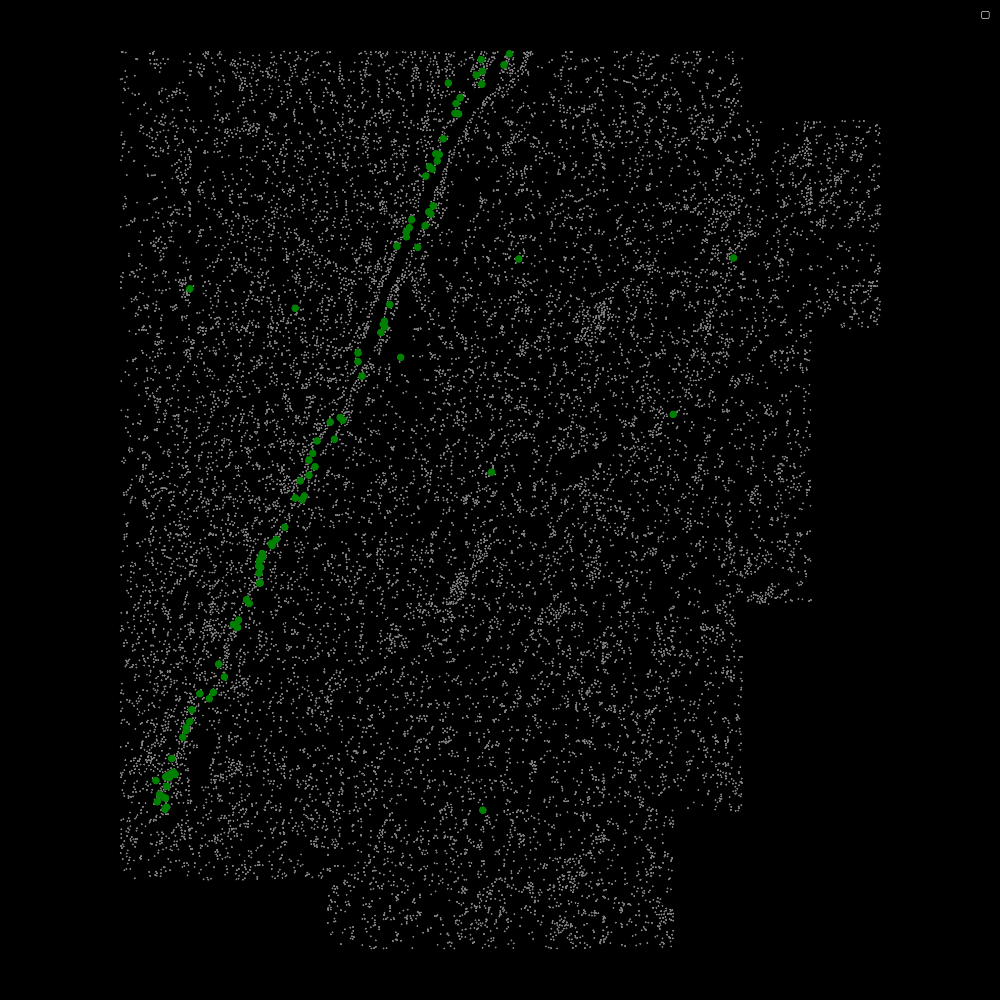

In [49]:
humaningj.plot_cluster_scdata("neurogenesis_pathway", clusters=["Stage 1"], ref=human, sbig=200)

# Supplementary Figure 8

# Figure A

Numbers of cells which have at least 10 transcripts of a gene total transcripts per cell (median 40, left graph) and number of cells that has X transcript detected per cell (median 2654, right graph)

In [28]:
import matplotlib.pyplot as plt
import numpy as np

def plot_histogram(ax, nums, xmax, bins=100):
    n, _, _ = ax.hist(nums, bins=bins, range=(0,xmax))
    median = np.median(nums)
    ax.axvline(median, ls=":", c="r")
    ax.text(median*1.05, np.max(n)*0.95, s=f"Median: {median:.0f}", c="r")

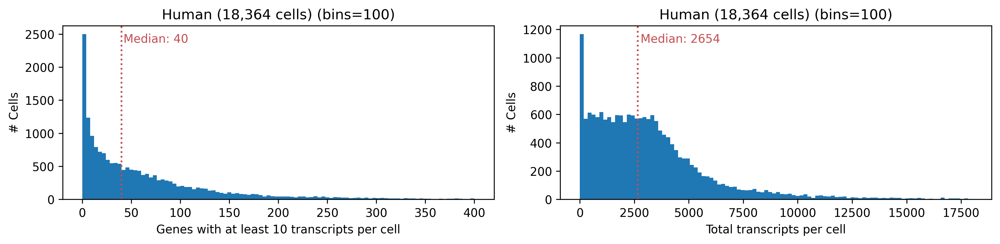

In [29]:
import matplotlib.pyplot as plt
import numpy as np

plt.style.use('default')
fig, axs = plt.subplots(1, 2, figsize=(12,3), dpi=150, facecolor="w")
# fig, axs = plt.subplots(2, 3, figsize=(12,6), dpi=150, facecolor="w")

ax = axs[0]
nums = list(np.sum(human.obsm["X_raw"] >= 10, axis=1).flat)
plot_histogram(ax, nums, xmax=400)
ax.set_xlabel("Genes with at least 10 transcripts per cell")
ax.set_ylabel("# Cells")
ax.set_title(f"Human ({len(nums):,d} cells) (bins=100)")

ax = axs[1]
nums = list(np.sum(human.obsm["X_raw"], axis=1).flat)
plot_histogram(ax, nums, xmax=18000)
ax.set_xlabel("Total transcripts per cell")
ax.set_ylabel("# Cells")
ax.set_title(f"Human ({len(nums):,d} cells) (bins=100)")

    
plt.tight_layout()
# plt.savefig("./figures/human_all_genes_10_tx_per_cell.png", dpi=150, bbox_inches="tight")

# Figure B

Vim, Sox2, GFAP, and C1ql3 mean transcripts per cell depicted in the transcriptional UMAP of the human SVZ as well as in their original position in the tissue.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

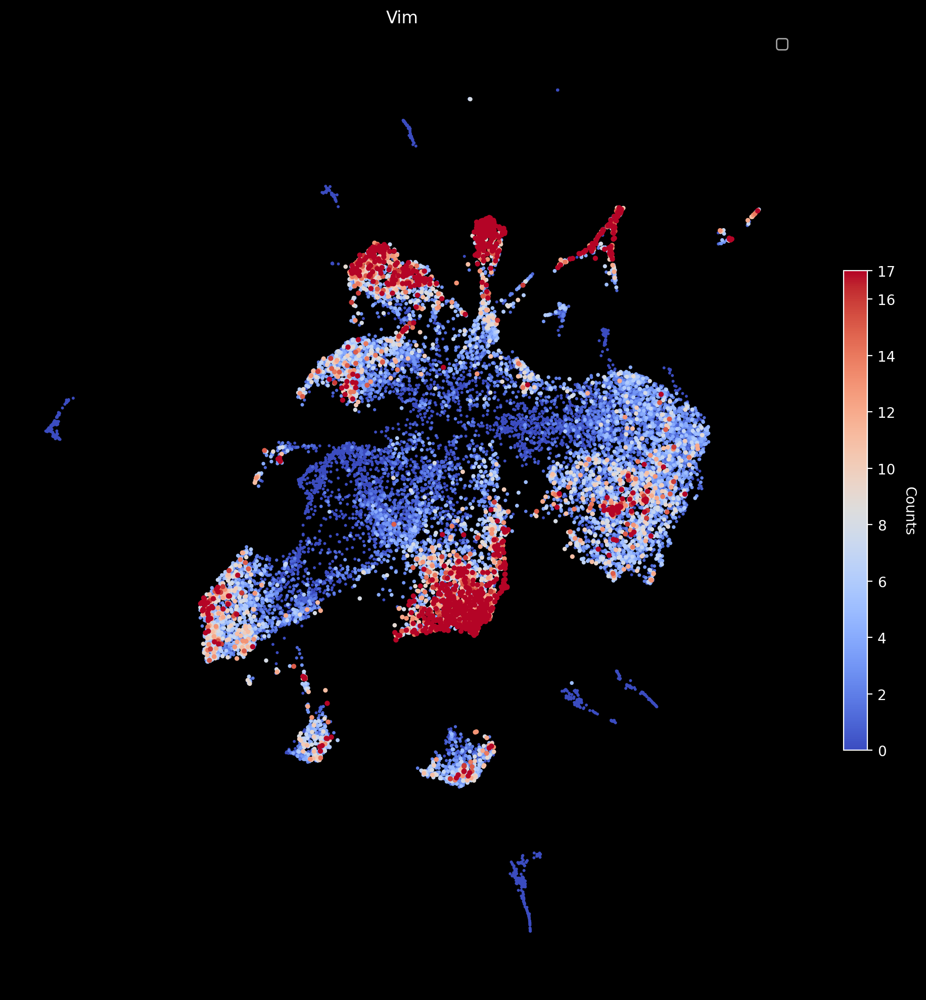

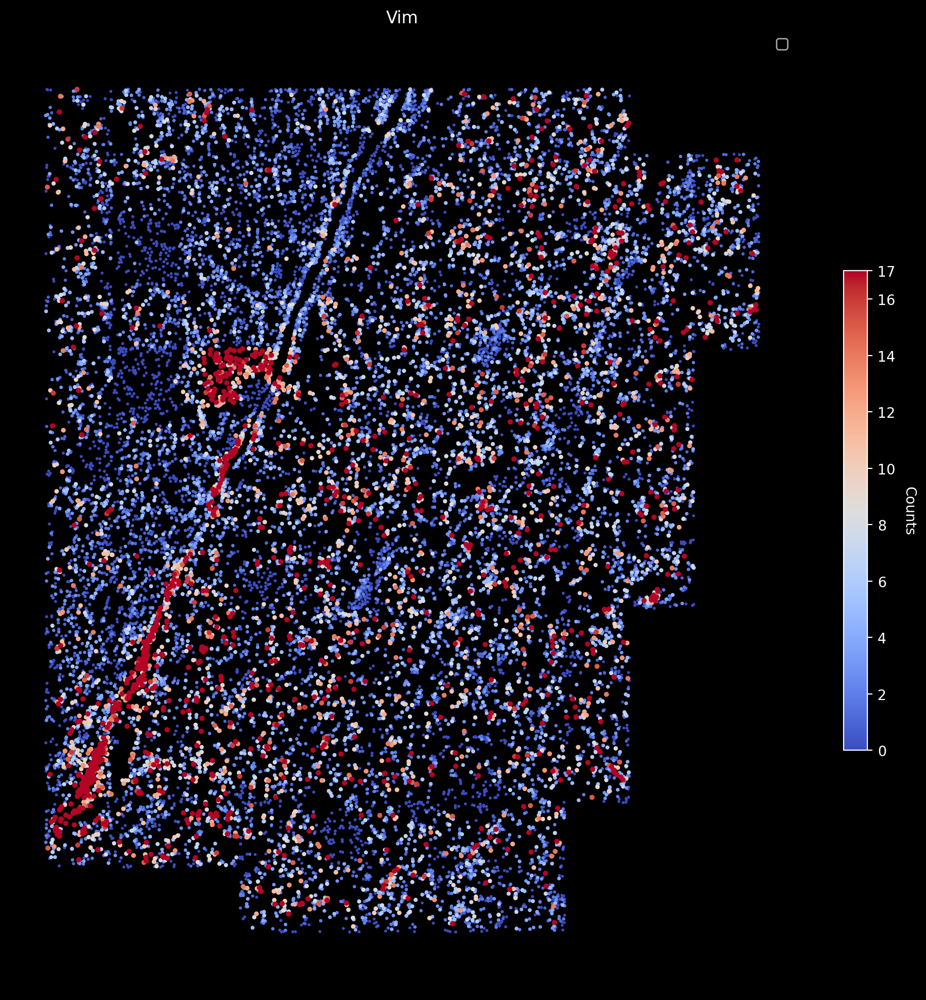

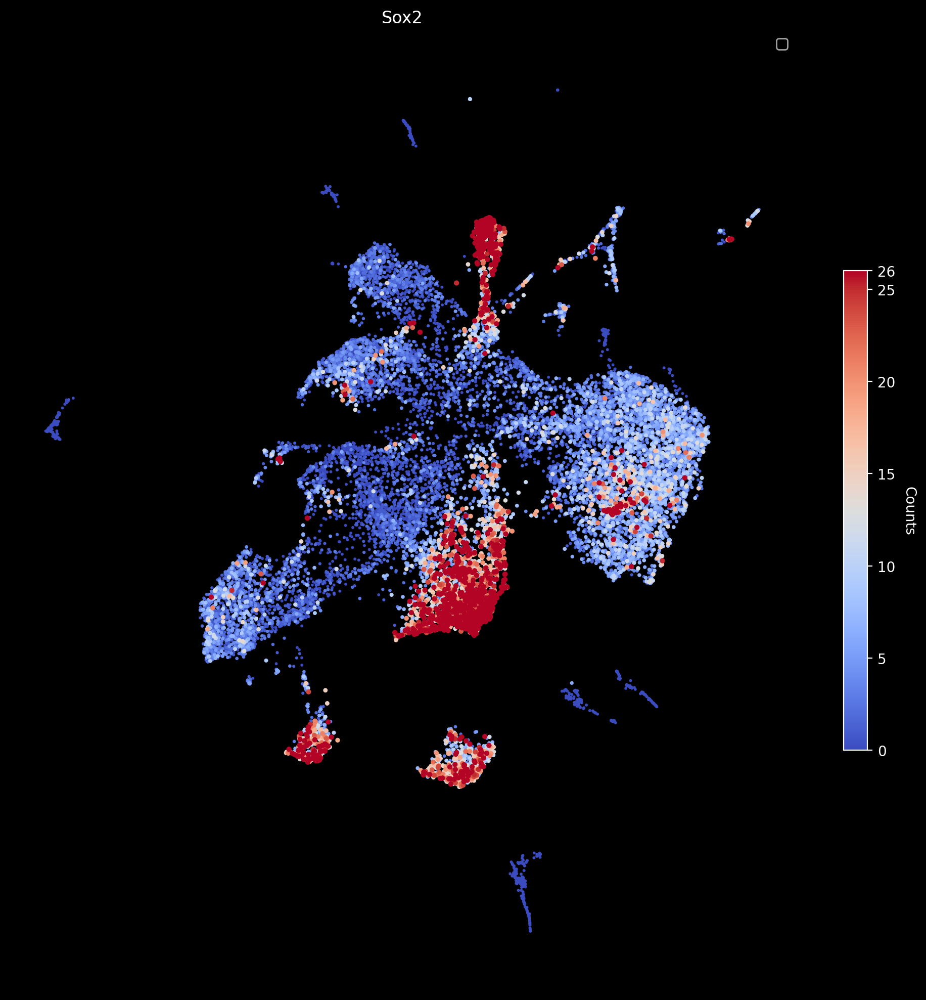

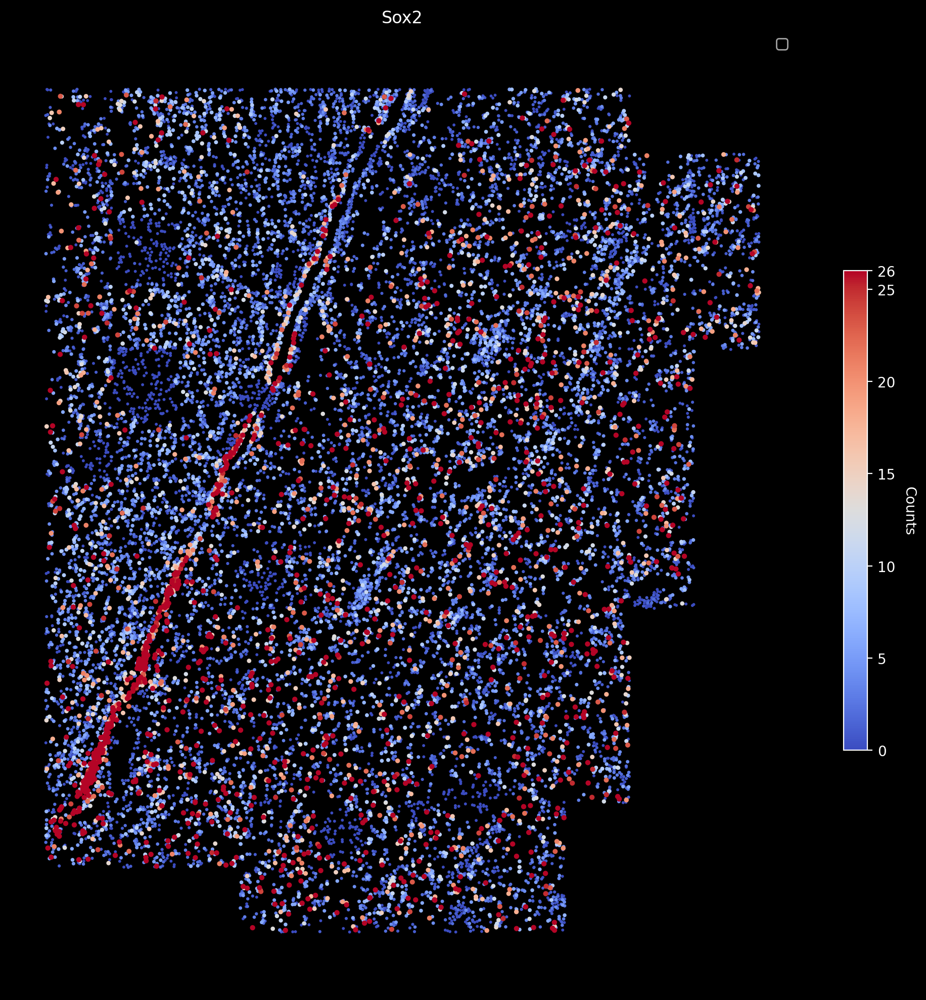

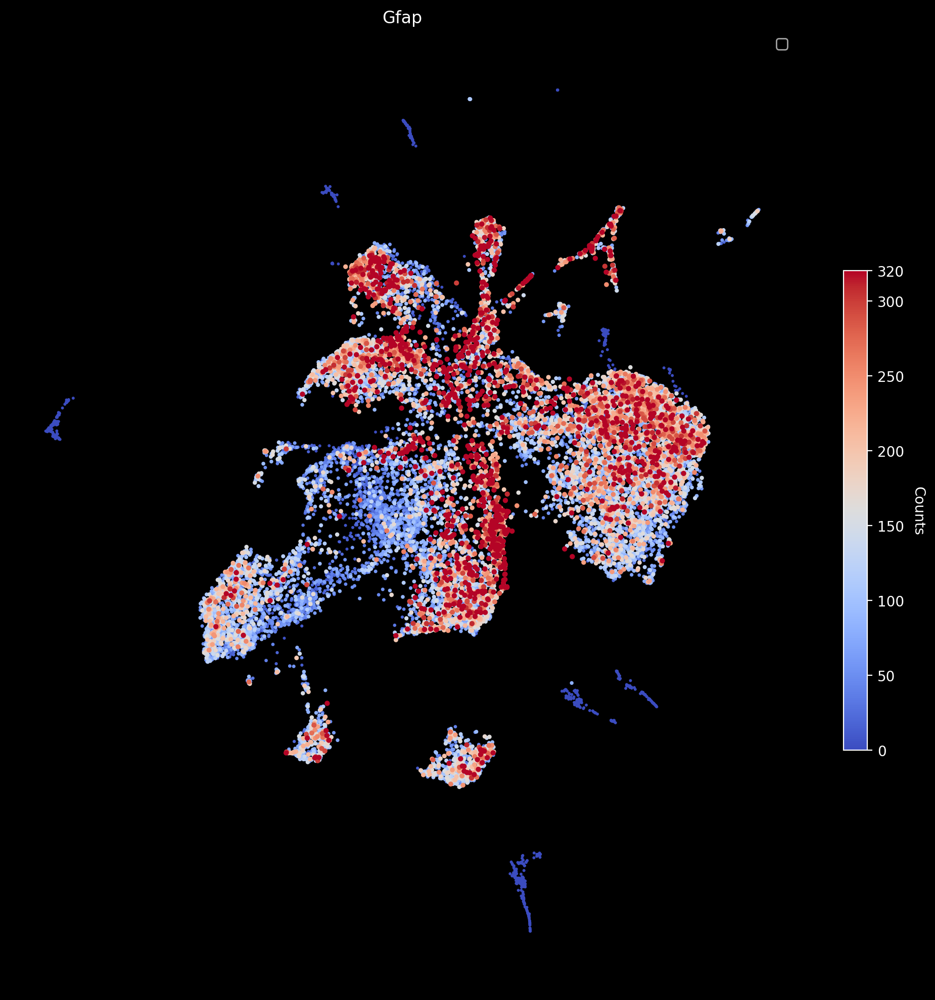

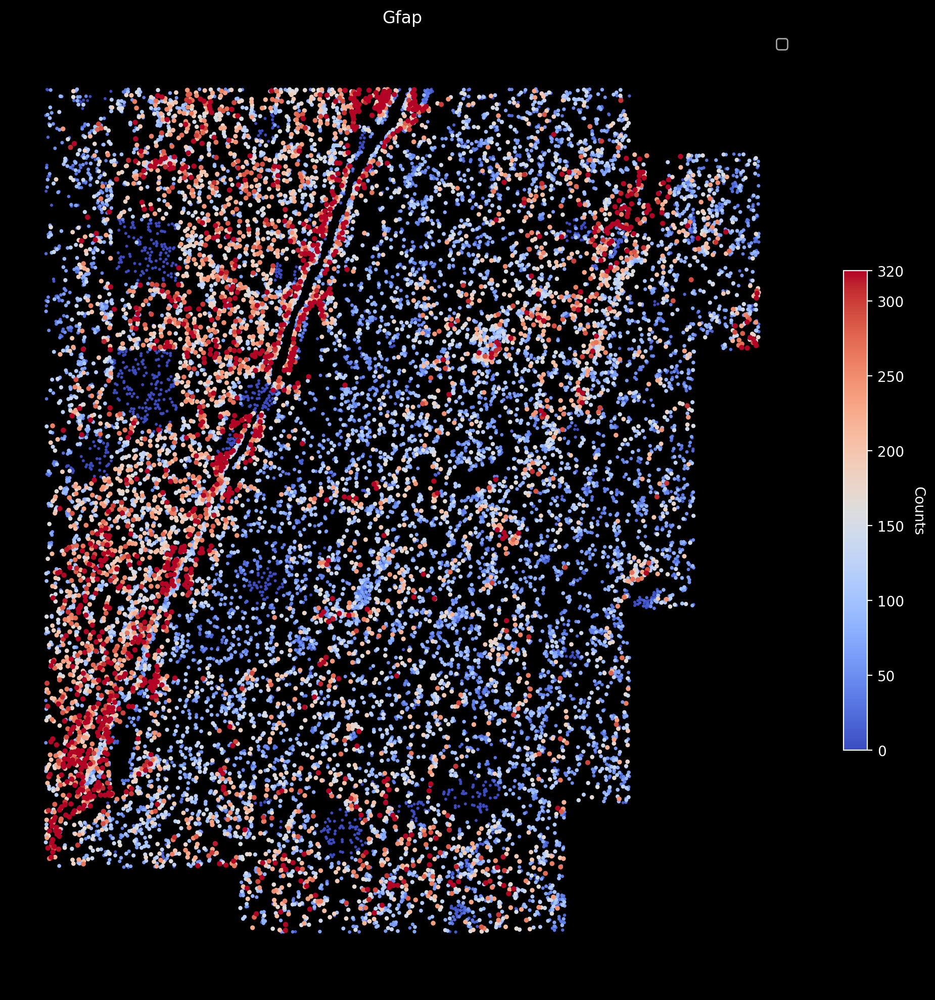

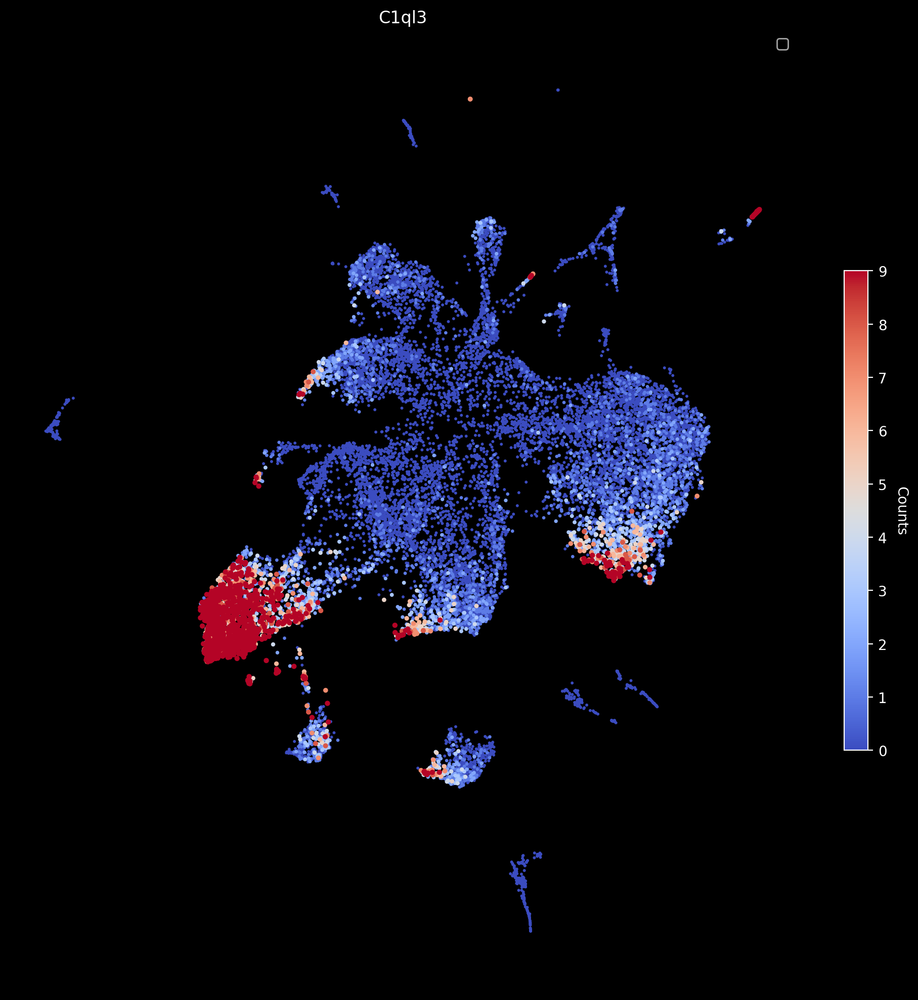

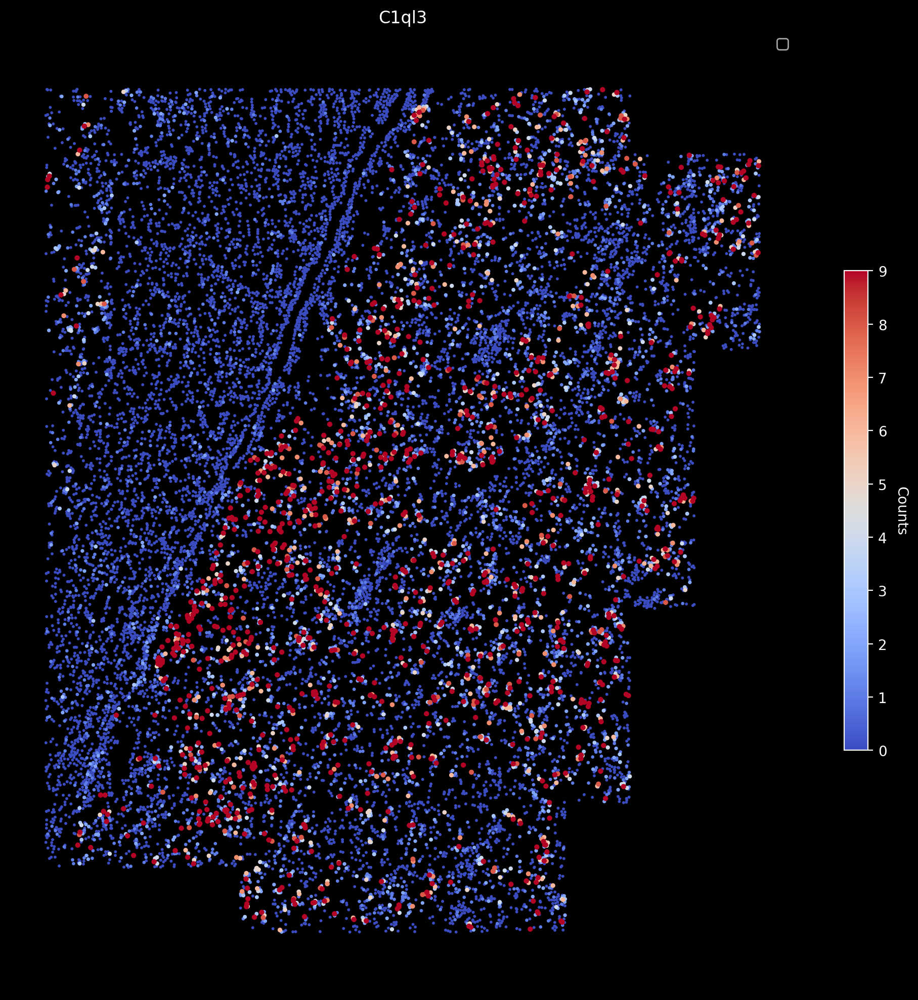

In [34]:
genes = [
    "Vim",
    "Sox2",
    "Gfap",
    "C1ql3"
]

humanj.data.var.index = humanj.data.var.index.str.capitalize()

for gene in genes:
    humanj.plot_gene_scdata(gene=gene, umap=True, fig=(10,10))
    humanj.plot_gene_scdata(gene=gene, umap=False, fig=(10,10))
